<a href="https://colab.research.google.com/github/Chrisolande/Machine-Learning-and-Data-Science-Projects/blob/main/Indian_Liver_Patient_Classification_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

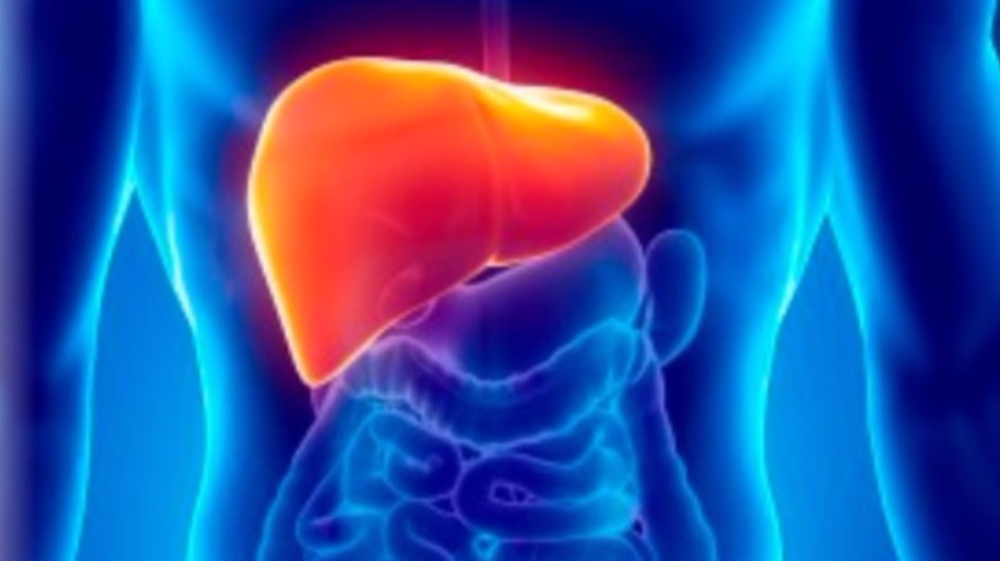

**About Dataset**

**Context**

Patients with Liver disease have been continuously increasing because of excessive consumption of alcohol, inhale of harmful gases, intake of contaminated food, pickles and drugs. This dataset was used to evaluate prediction algorithms in an effort to reduce burden on doctors.

**Content**

This data set contains 416 liver patient records and 167 non liver patient records collected from North East of Andhra Pradesh, India. The "Dataset" column is a class label used to divide groups into liver patient (liver disease) or not (no disease). This data set contains 441 male patient records and 142 female patient records.

Any patient whose age exceeded 89 is listed as being of age "90".

**Columns:**

* Age of the patient

* Gender of the patient

* Total Bilirubin

* Direct Bilirubin

* Alkaline Phosphotase

* Alamine Aminotransferase

* Aspartate Aminotransferase

* Total Protiens

* Albumin

*Albumin and Globulin Ratio

**Dataset**: field used to split the data into two sets (patient with liver disease, or no disease)
Acknowledgements
This dataset was downloaded from the UCI ML Repository:

Lichman, M. (2013). UCI Machine Learning Repository [http://archive.ics.uci.edu/ml]. Irvine, CA: University of California, School of Information and Computer Science.

**Inspiration**
Use these patient records to determine which patients have liver disease and which ones do not.


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
sns.set_style('darkgrid')


In [3]:
from google.colab import files

uploaded = files.upload()

df = pd.read_csv(next(iter(uploaded)))

Saving indian_liver_patient.csv to indian_liver_patient (4).csv


In [5]:
df = df.rename(columns = {'Dataset': 'Target'})

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 583 entries, 0 to 582
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Age                         583 non-null    int64  
 1   Gender                      583 non-null    object 
 2   Total_Bilirubin             583 non-null    float64
 3   Direct_Bilirubin            583 non-null    float64
 4   Alkaline_Phosphotase        583 non-null    int64  
 5   Alamine_Aminotransferase    583 non-null    int64  
 6   Aspartate_Aminotransferase  583 non-null    int64  
 7   Total_Protiens              583 non-null    float64
 8   Albumin                     583 non-null    float64
 9   Albumin_and_Globulin_Ratio  579 non-null    float64
 10  Target                      583 non-null    int64  
dtypes: float64(5), int64(5), object(1)
memory usage: 50.2+ KB


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 583 entries, 0 to 582
Data columns (total 11 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Age                         583 non-null    int64  
 1   Gender                      583 non-null    object 
 2   Total_Bilirubin             583 non-null    float64
 3   Direct_Bilirubin            583 non-null    float64
 4   Alkaline_Phosphotase        583 non-null    int64  
 5   Alamine_Aminotransferase    583 non-null    int64  
 6   Aspartate_Aminotransferase  583 non-null    int64  
 7   Total_Protiens              583 non-null    float64
 8   Albumin                     583 non-null    float64
 9   Albumin_and_Globulin_Ratio  579 non-null    float64
 10  Target                      583 non-null    int64  
dtypes: float64(5), int64(5), object(1)
memory usage: 50.2+ KB


In [8]:
import ydata_profiling as yp

profile_report = yp.ProfileReport(df)

profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (583, 11)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    11 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix data quality issues automatically, import FixDQ from autoviz...
    Alert: Dropping 13 duplicate rows can sometimes cause column data types to change to object. Double-check!


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Age,int64,0.000000,12,4.000000,90.000000,No issue
Gender,object,0.000000,0,nan,nan,No issue
Total_Bilirubin,float64,0.000000,NA,0.400000,75.000000,has 83 outliers greater than upper bound (5.30) or lower than lower bound(-1.90). Cap them or remove them.
Direct_Bilirubin,float64,0.000000,NA,0.100000,19.700000,"has 80 outliers greater than upper bound (2.95) or lower than lower bound(-1.45). Cap them or remove them., has a high correlation with ['Total_Bilirubin']. Consider dropping one of them."
Alkaline_Phosphotase,int64,0.000000,46,63.000000,2110.000000,has 69 outliers greater than upper bound (481.00) or lower than lower bound(-7.00). Cap them or remove them.
Alamine_Aminotransferase,int64,0.000000,26,10.000000,2000.000000,has 72 outliers greater than upper bound (115.50) or lower than lower bound(-32.50). Cap them or remove them.
Aspartate_Aminotransferase,int64,0.000000,31,10.000000,4929.000000,has 66 outliers greater than upper bound (179.38) or lower than lower bound(-67.62). Cap them or remove them.
Total_Protiens,float64,0.000000,NA,2.700000,9.600000,has 8 outliers greater than upper bound (9.30) or lower than lower bound(3.70). Cap them or remove them.
Albumin,float64,0.000000,NA,0.900000,5.500000,No issue
Albumin_and_Globulin_Ratio,float64,0.701754,NA,0.300000,2.800000,"4 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 10 outliers greater than upper bound (1.70) or lower than lower bound(0.10). Cap them or remove them."


Number of All Scatter Plots = 15


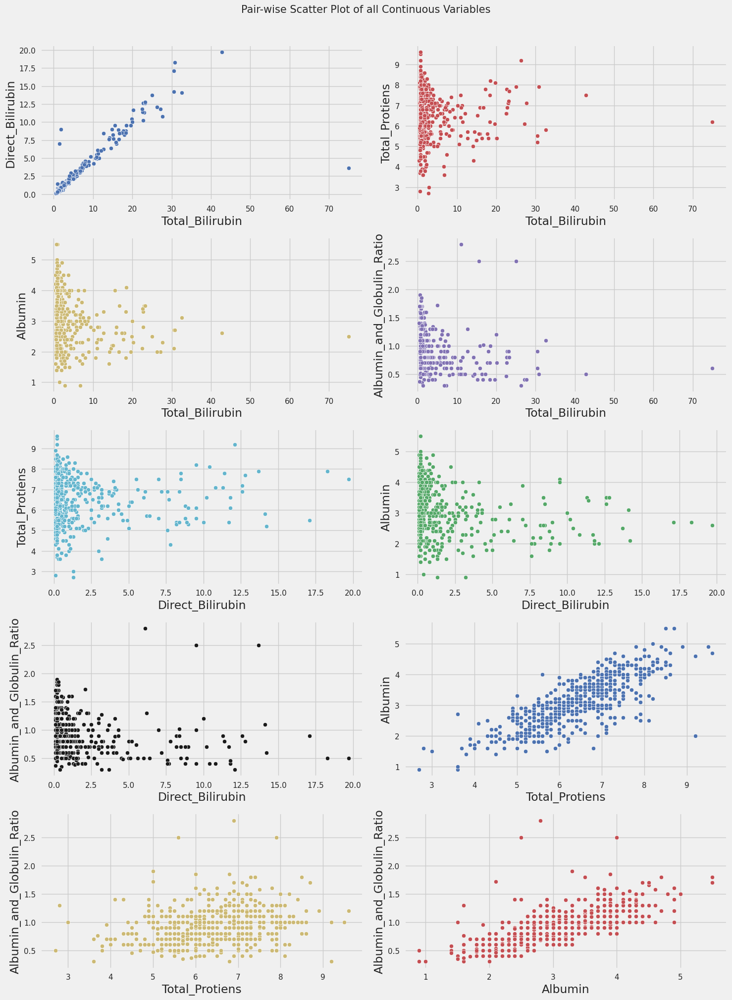

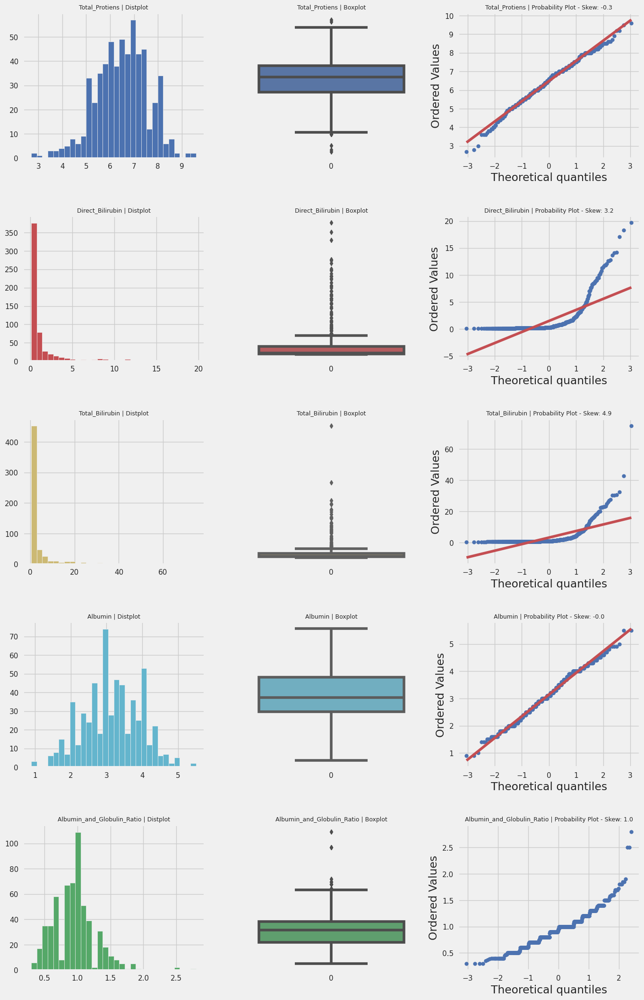

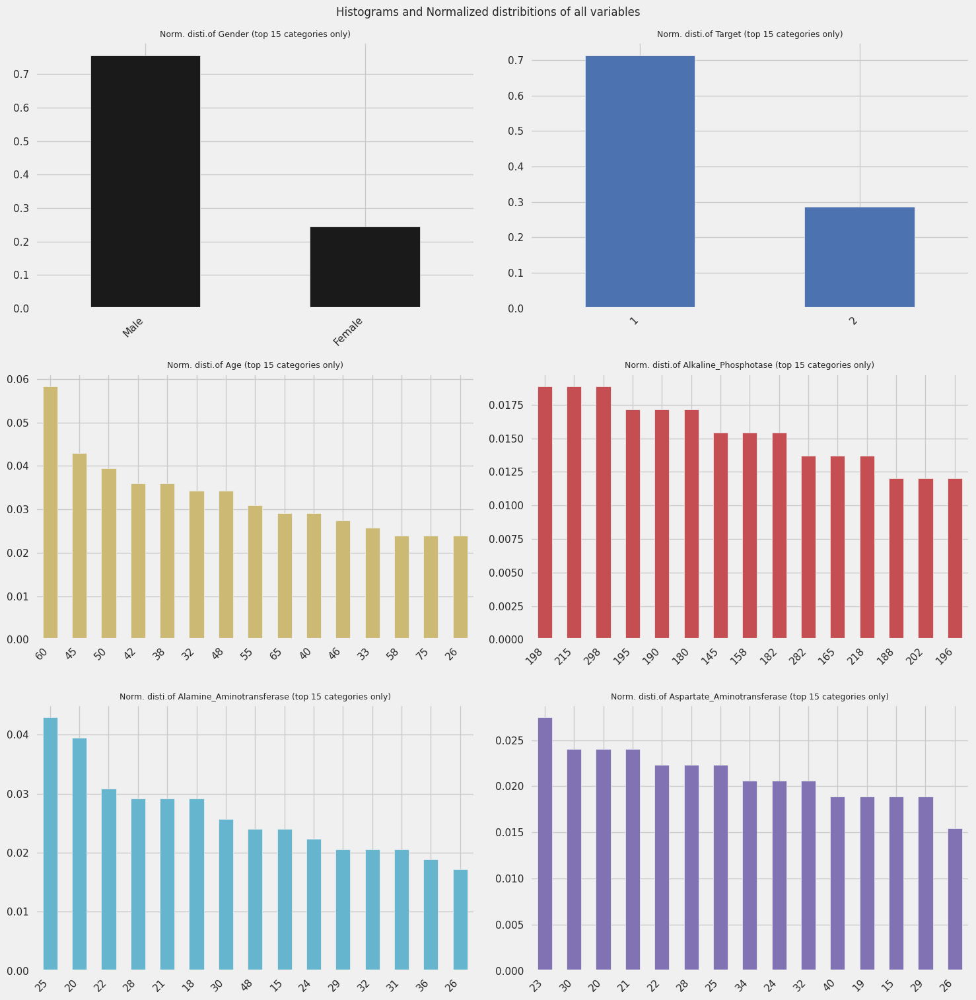

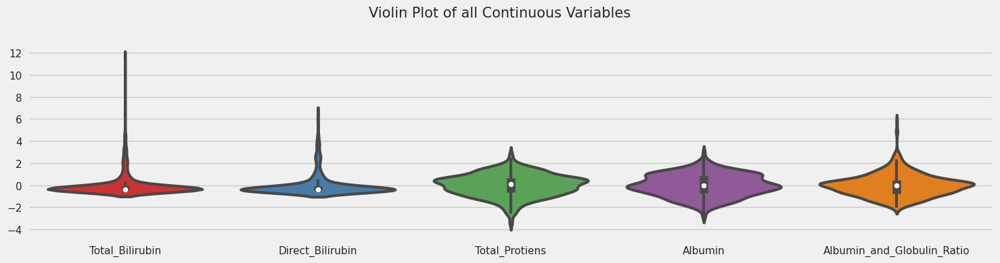

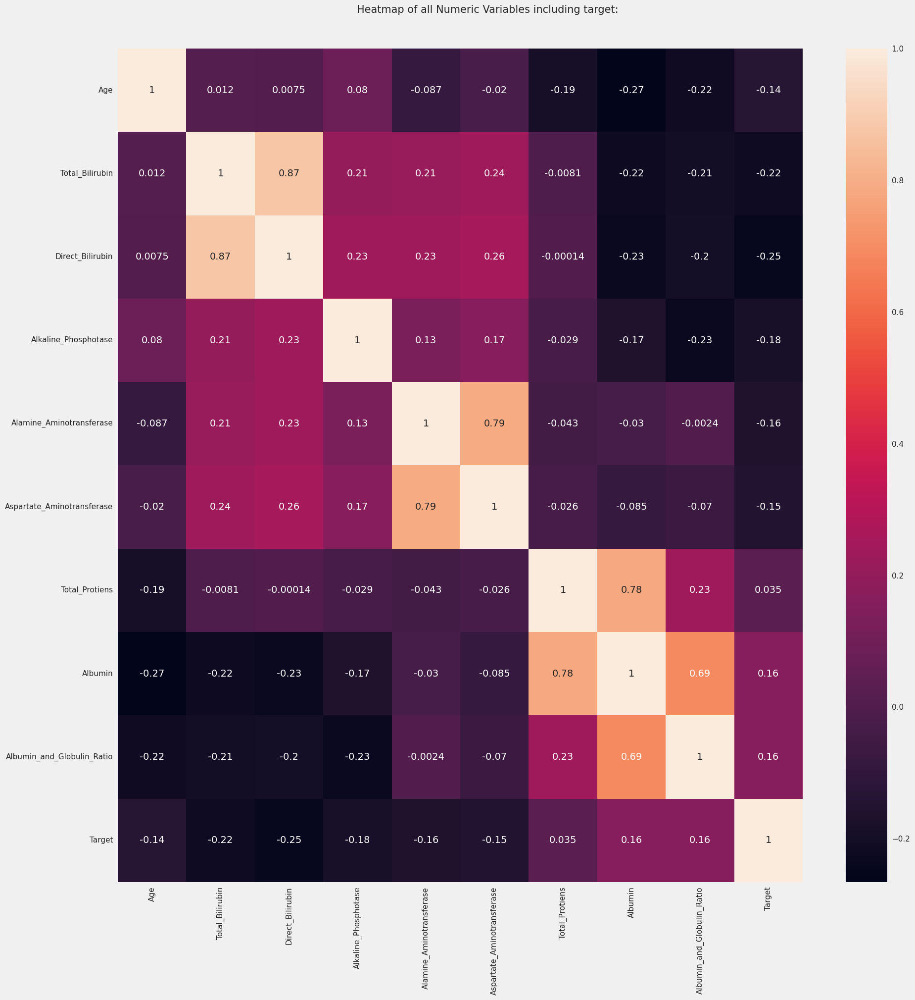

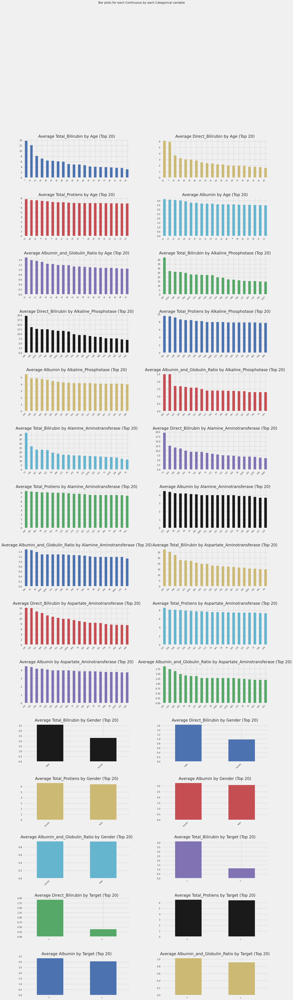

All Plots done
Time to run AutoViz = 29 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [9]:
from autoviz.AutoViz_Class import AutoViz_Class

%matplotlib inline

AV = AutoViz_Class()

dft = AV.AutoViz(
    "",
    sep=",",
    depVar="",
    dfte=df,
    header=0,
    verbose=1,
    lowess=False,
    max_rows_analyzed=150000,
    max_cols_analyzed=30,
    save_plot_dir=None
)

**Observation**

1. There are 4 missing cells accounting for 0.1% of the entire dataset

2. There are 14 duplicated values accounting for 2.2% of the entire dataset

3. There are outliers existing in some features

In [10]:
#Numerical Features

numerical_feat = df.select_dtypes(include= 'number')

numerical_feat

,Age,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Target
0,65,0.7,0.1,187,16,18,6.8,3.3,0.90,1
1,62,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,1.0,0.4,182,14,20,6.8,3.4,1.00,1
4,72,3.9,2.0,195,27,59,7.3,2.4,0.40,1
...,...,...,...,...,...,...,...,...,...,...
578,60,0.5,0.1,500,20,34,5.9,1.6,0.37,2
579,40,0.6,0.1,98,35,31,6.0,3.2,1.10,1
580,52,0.8,0.2,245,48,49,6.4,3.2,1.00,1
581,31,1.3,0.5,184,29,32,6.8,3.4,1.00,1


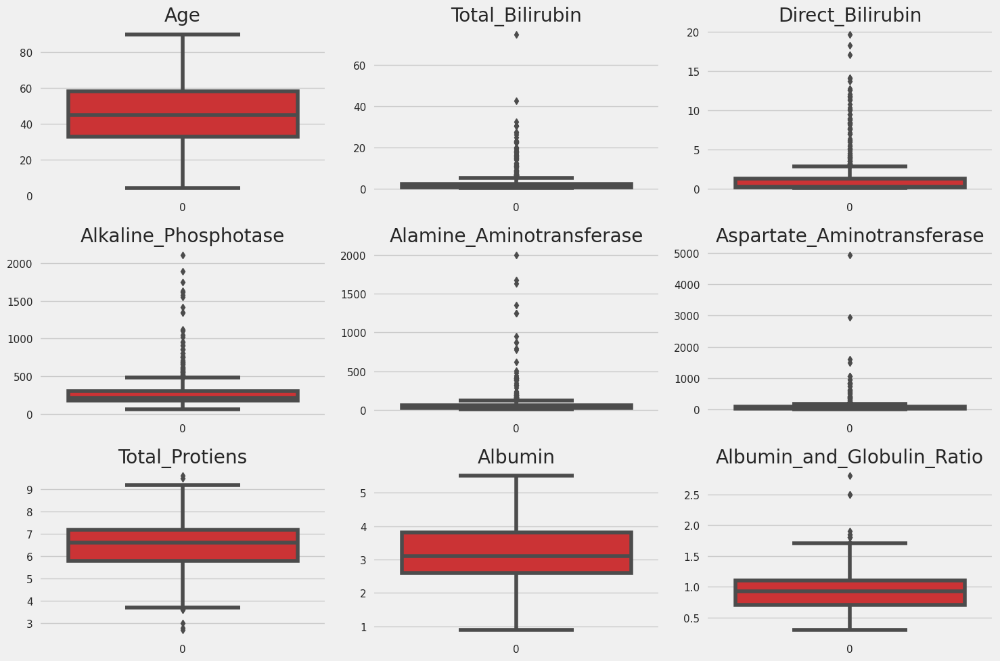

In [11]:
features = [c for c in numerical_feat.columns if c != 'Target']

num_features = len(features)

num_cols = 3

num_rows = (num_features + num_cols -1) // num_cols

plt.figure(figsize= (15,10))

for idx, feature in enumerate(features):

  plt.subplot(num_rows, num_cols, idx+1)

  sns.boxplot(df[feature])

  plt.title(f"{feature}")

plt.tight_layout()

plt.show()

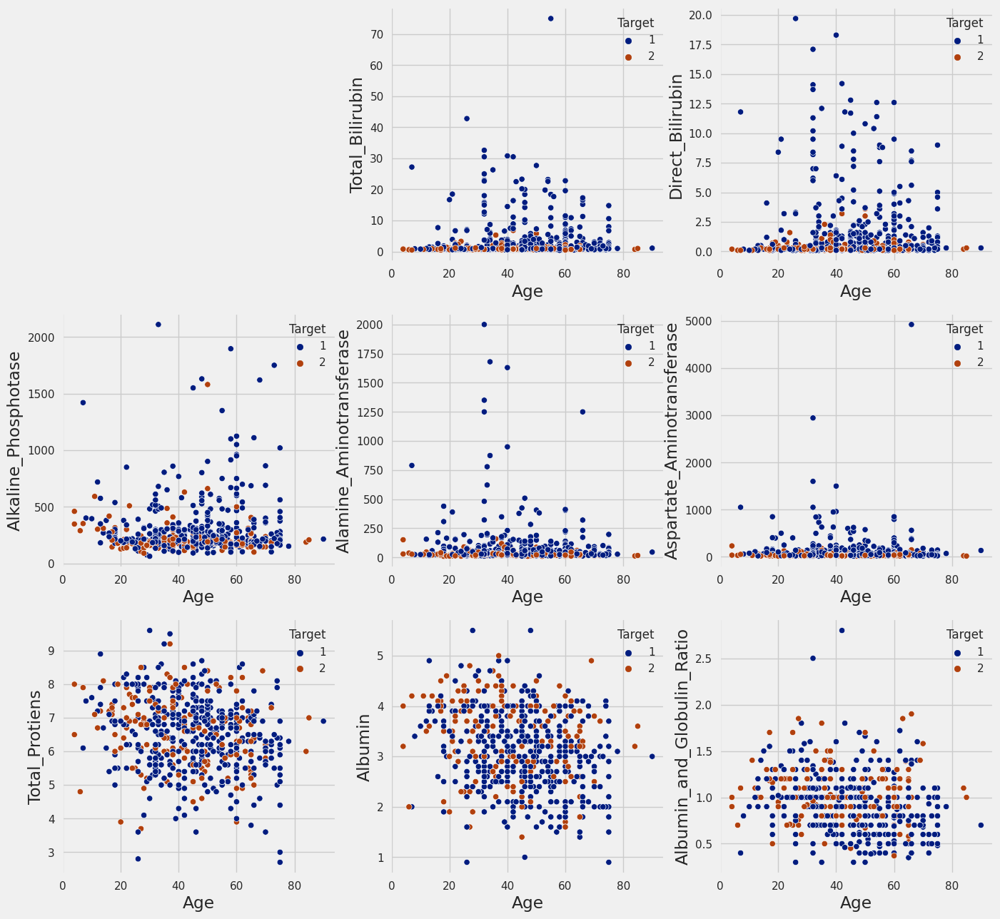

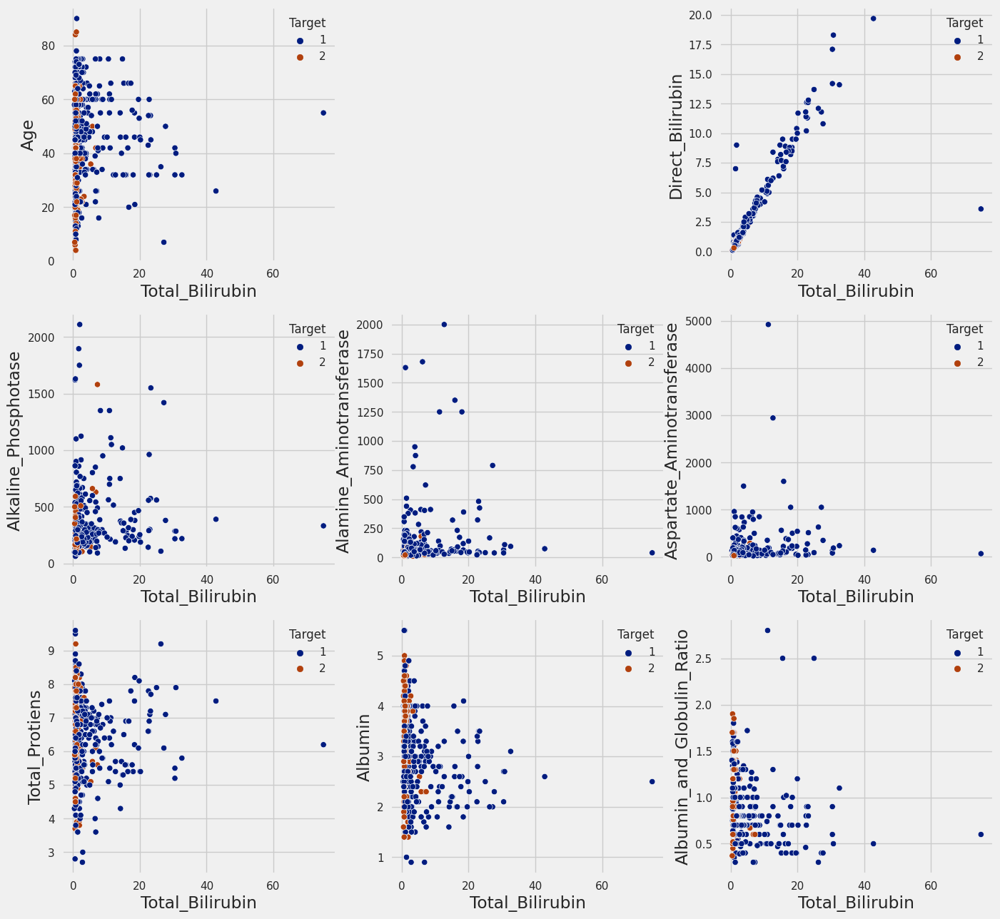

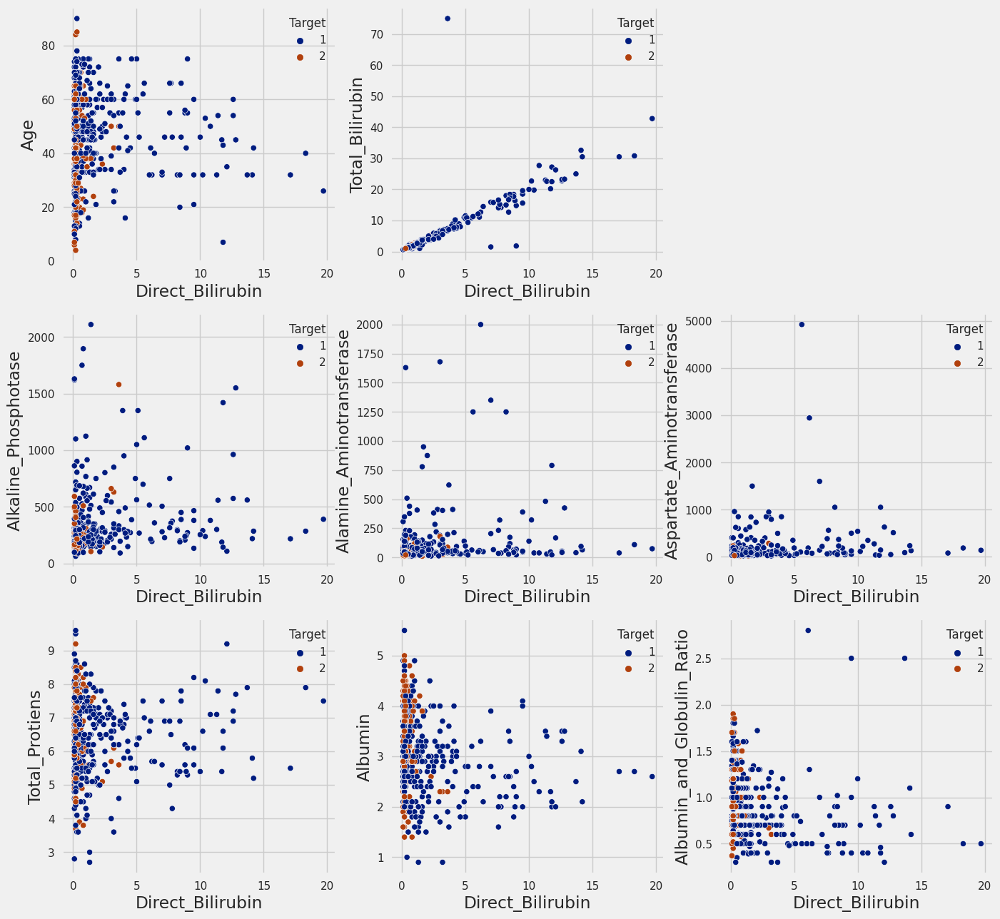

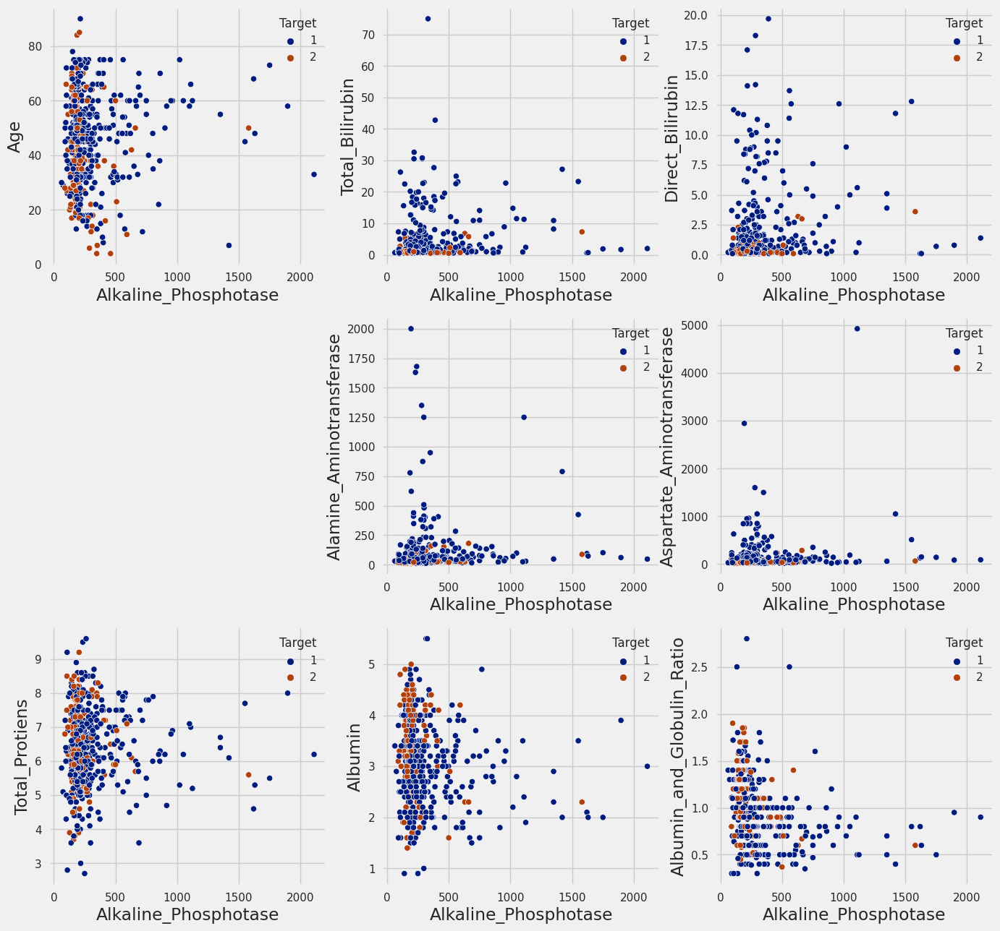

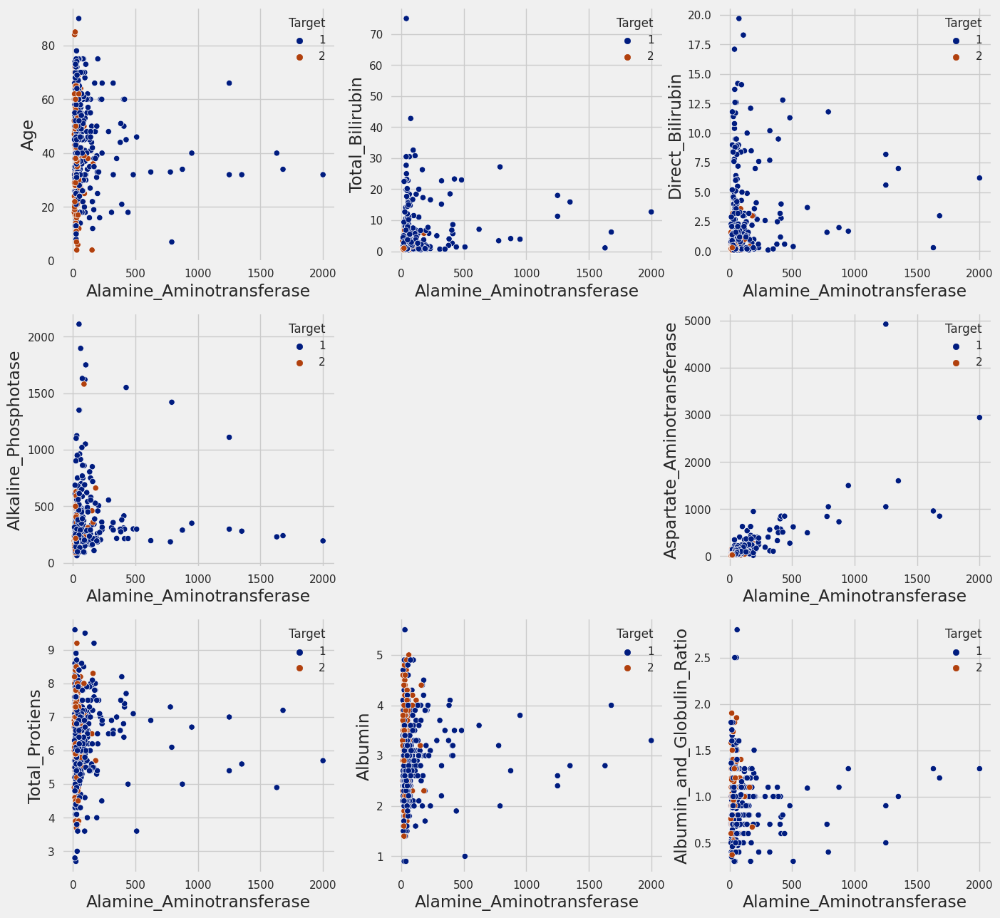

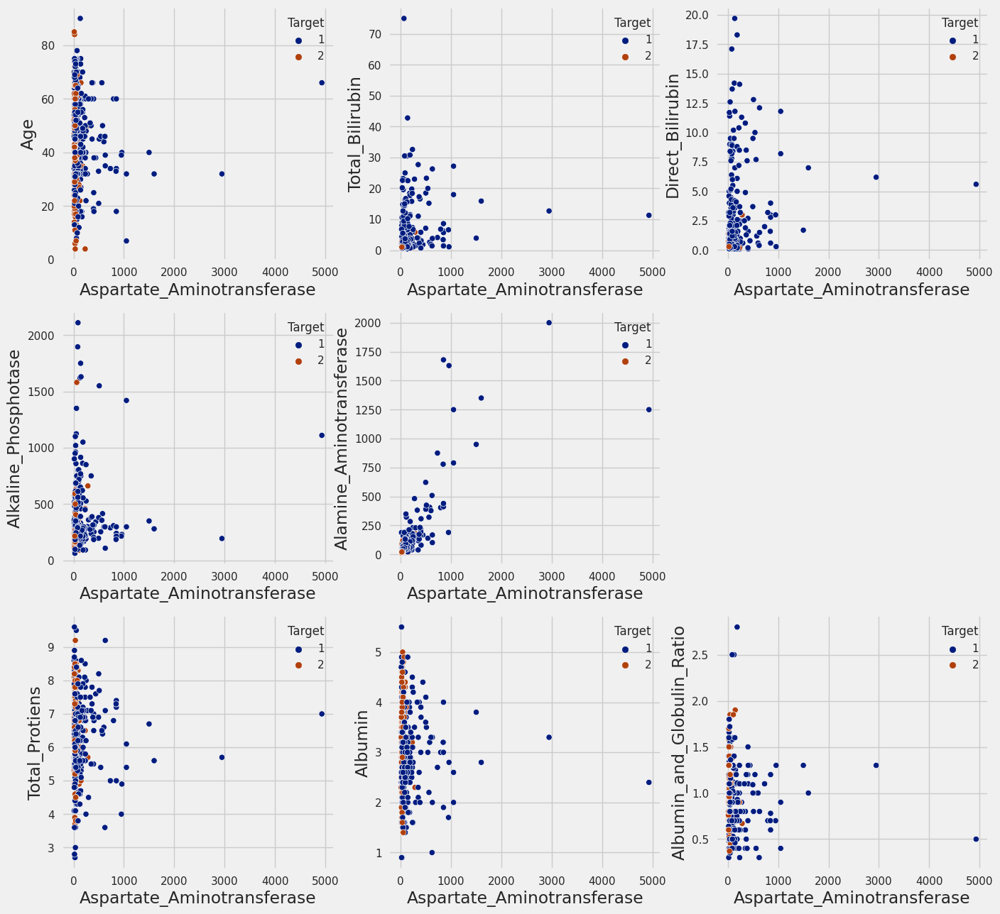

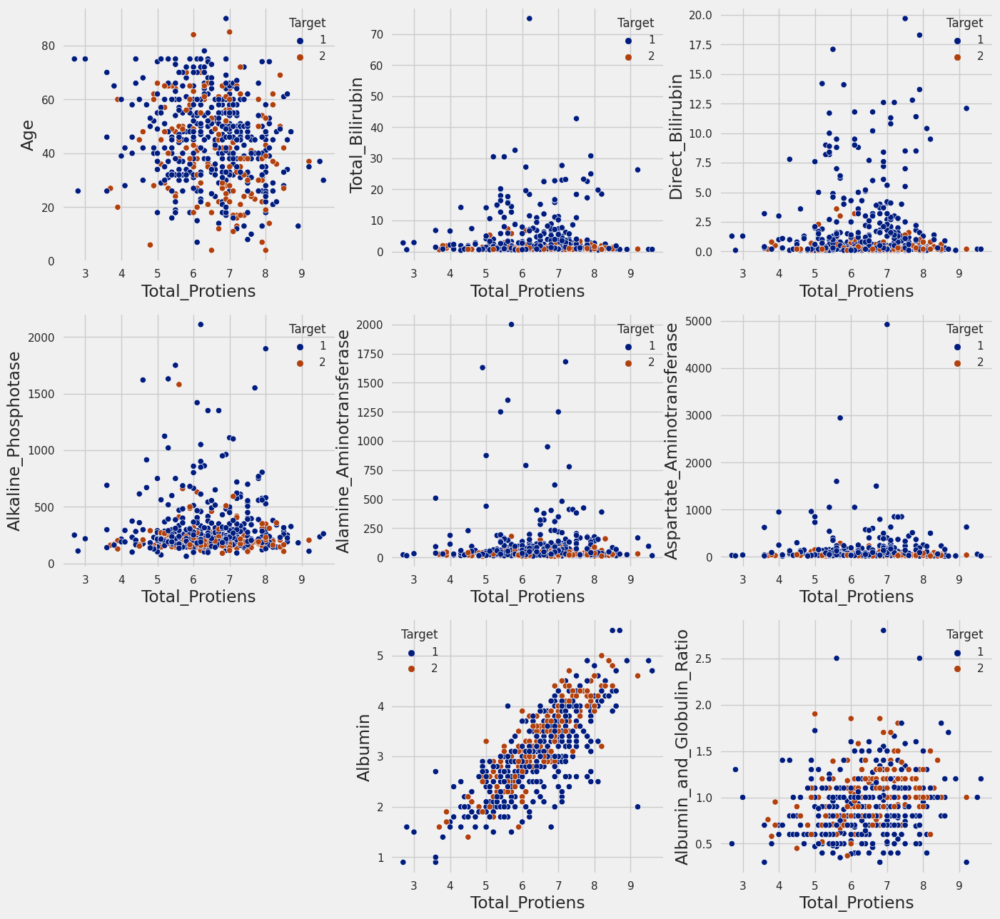

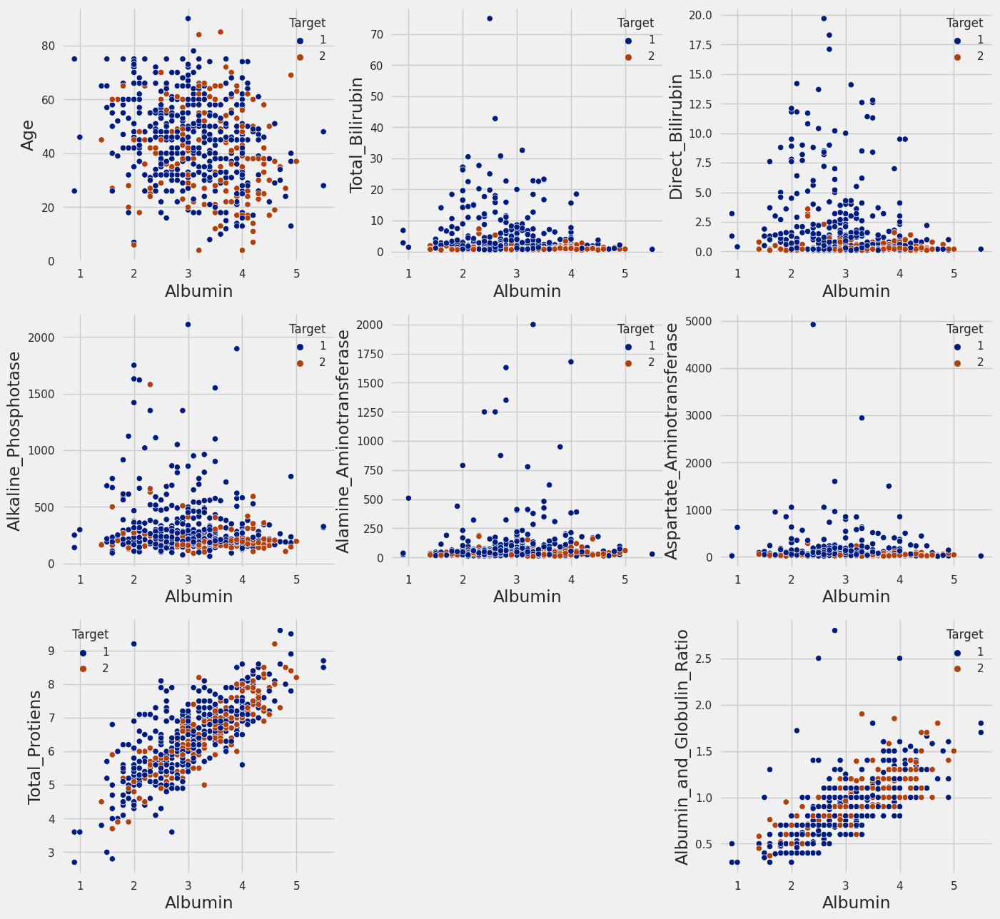

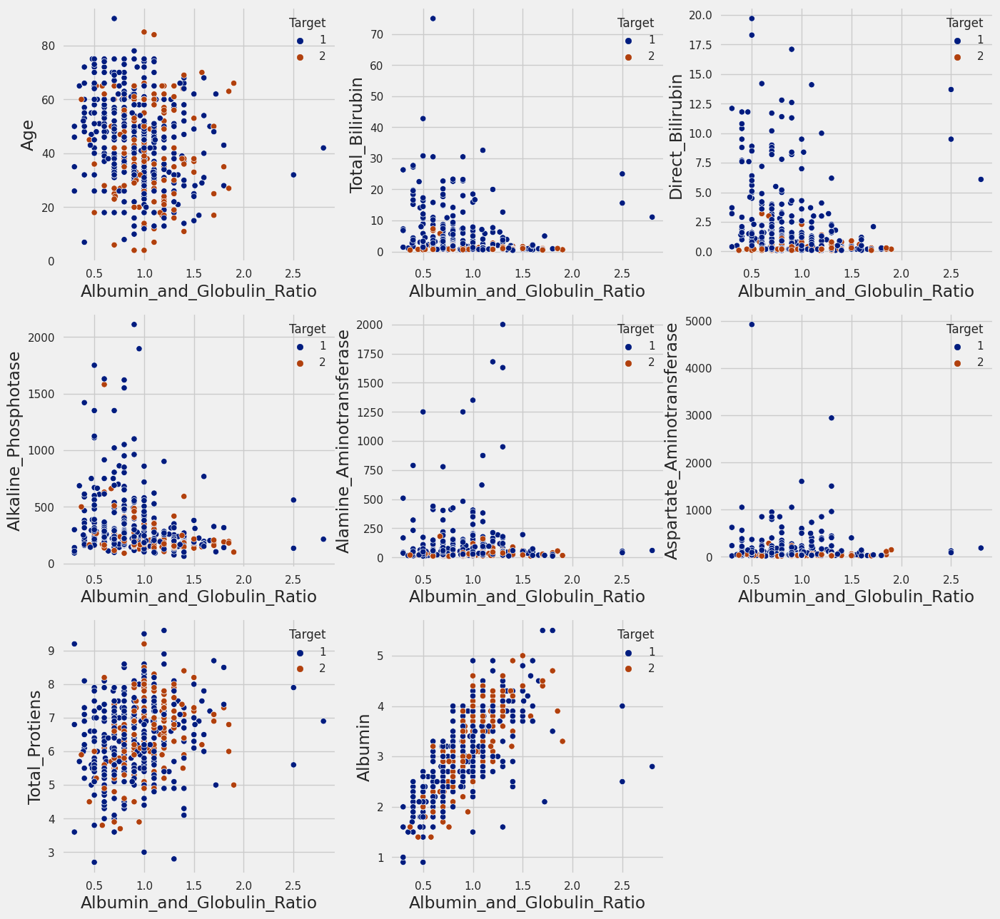

In [12]:
liver_data_num = df.columns

liver_data_num = liver_data_num.drop(['Gender', 'Target'])

plt_num= 1

for column1 in liver_data_num:

  if plt_num <= 9:

    plt_num2 = 1

    plt.figure(figsize= (15, 15))

    for column2 in liver_data_num:

      if plt_num2 <= 9:

        if column2 != column1:

          plt.subplot(3,3,plt_num2)

          sns.scatterplot(x= column1, y= column2, data= df, hue= 'Target', palette= 'dark')

      plt_num2 += 1

  plt.show()

  plt_num += 1


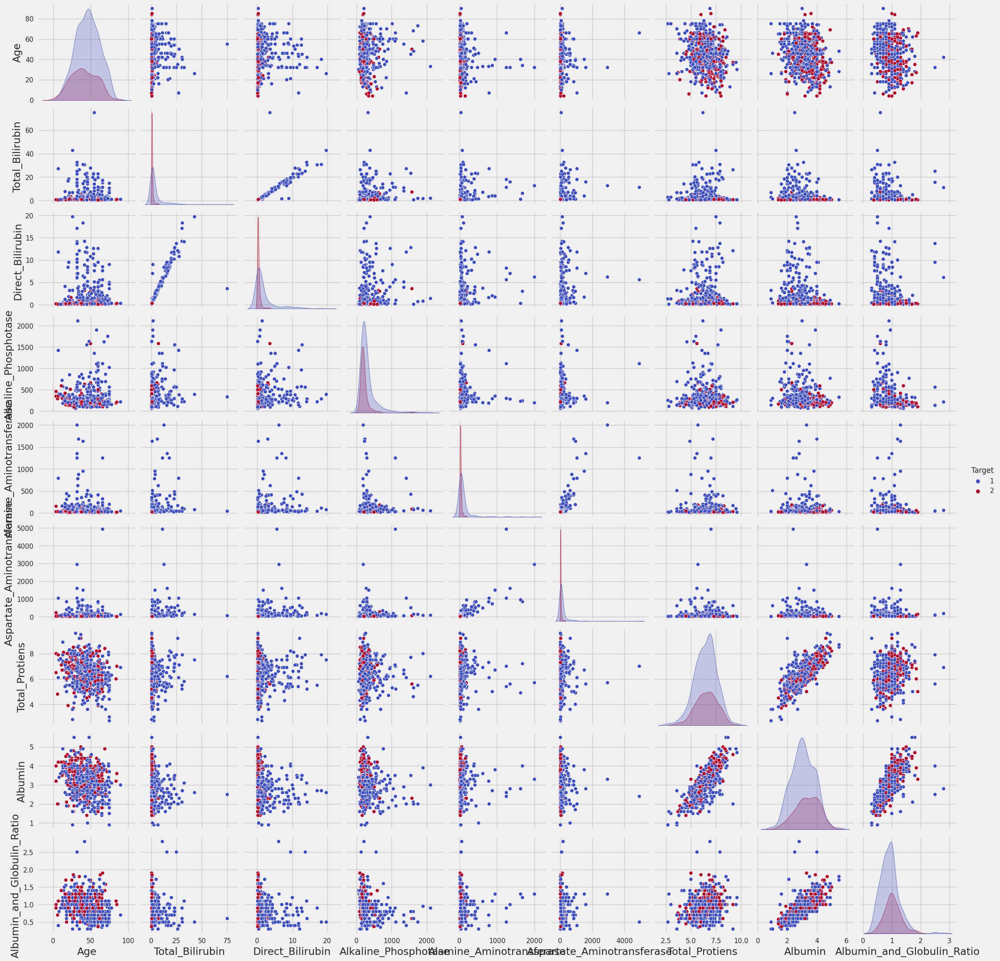

In [13]:
sns.pairplot(data= df, hue= 'Target', palette= 'coolwarm')

plt.show()

# Data Preprocessing

In [14]:
#Null Values

df.isnull().sum()

Age                           0
Gender                        0
Total_Bilirubin               0
Direct_Bilirubin              0
Alkaline_Phosphotase          0
Alamine_Aminotransferase      0
Aspartate_Aminotransferase    0
Total_Protiens                0
Albumin                       0
Albumin_and_Globulin_Ratio    4
Target                        0
dtype: int64

There are 4 missing values

## Handling the duplicates values

In [15]:
df.drop_duplicates(inplace= True)


## Handling the missing values

In [16]:
#imputing the missing values with the median

df['Albumin_and_Globulin_Ratio'] = df['Albumin_and_Globulin_Ratio'].fillna(df['Albumin_and_Globulin_Ratio'].median())

## Encoding the Gender

In [17]:
gender_encoded = {'Female': 0, 'Male': 1}

df['Gender'] = df['Gender'].map(gender_encoded)

# Feature Selection

## Using VIF to check for multi-Collinearlity

In [18]:
independent_vars = df.drop(columns= ['Gender', 'Target']).columns.to_list()

independent_vars

['Age',
 'Total_Bilirubin',
 'Direct_Bilirubin',
 'Alkaline_Phosphotase',
 'Alamine_Aminotransferase',
 'Aspartate_Aminotransferase',
 'Total_Protiens',
 'Albumin',
 'Albumin_and_Globulin_Ratio']

In [19]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.formula.api as smf

independent_vars = df.drop(columns= ['Gender', 'Target']).columns.to_list()

vif_data = pd.DataFrame(columns=['Variable', 'VIF'])

for var in independent_vars:

    formula = f"{var} ~ {' + '.join([v for v in independent_vars if v != var])}"

    rsquared = smf.ols(formula, data=df).fit().rsquared

    vif = 1 / (1 - rsquared)

    vif_data = vif_data.append({'Variable': var, 'VIF': vif}, ignore_index=True)

vif_data

,Variable,VIF
0,Age,1.098928
1,Total_Bilirubin,4.261688
2,Direct_Bilirubin,4.505851
3,Alkaline_Phosphotase,1.118597
4,Alamine_Aminotransferase,2.813267
5,Aspartate_Aminotransferase,2.807099
6,Total_Protiens,5.529657
7,Albumin,10.017208
8,Albumin_and_Globulin_Ratio,3.622436


Albumin and Total Proteins have high VIF but we aint dropping them because theyre too important

In [20]:
from sklearn.feature_selection import SelectKBest
from sklearn.preprocessing import StandardScaler

X, y = df[[c for c in df.columns if c != 'Target']], df['Target']

scaler = StandardScaler()

X_scaled = scaler.fit_transform(X)

X_scaled = pd.DataFrame(X_scaled, columns= X.columns)

df_scaled = pd.concat([X_scaled.reset_index(drop= True), y.reset_index(drop= True)], axis= 1)

df_scaled

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Aspartate_Aminotransferase,Total_Protiens,Albumin,Albumin_and_Globulin_Ratio,Target
0,1.241741,-1.752549,-0.418647,-0.493702,-0.427421,-0.351482,-0.314428,0.279290,0.189737,-0.150889,1
1,1.056874,0.570597,1.210111,1.413923,1.661722,-0.086746,-0.032278,0.923059,0.064127,-0.653669,1
2,1.056874,0.570597,0.635255,0.919354,0.808927,-0.108807,-0.142385,0.463224,0.189737,-0.182313,1
3,0.810385,0.570597,-0.370743,-0.387723,-0.447823,-0.362513,-0.307546,0.279290,0.315348,0.163348,1
4,1.673096,0.570597,0.092336,0.177500,-0.394778,-0.290813,-0.173353,0.739125,-0.940754,-1.722078,1
...,...,...,...,...,...,...,...,...,...,...,...
565,0.933630,0.570597,-0.450584,-0.493702,0.849731,-0.329421,-0.259374,-0.548414,-1.945636,-1.816349,2
566,-0.298813,0.570597,-0.434616,-0.493702,-0.790573,-0.246691,-0.269697,-0.456447,0.064127,0.477586,1
567,0.440653,0.570597,-0.402679,-0.458375,-0.190760,-0.174991,-0.207761,-0.088579,0.064127,0.163348,1
568,-0.853413,0.570597,-0.322838,-0.352396,-0.439662,-0.279783,-0.266256,0.279290,0.315348,0.163348,1


## Utilzing the correlation

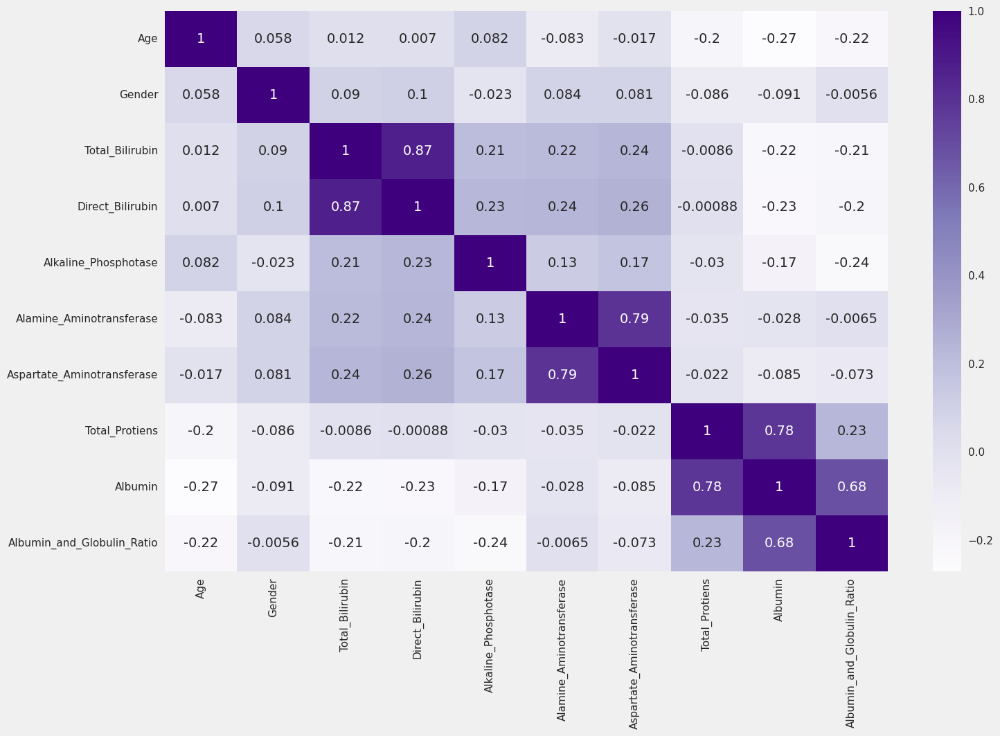

In [21]:
#using correlation to select features

plt.figure(figsize= (15, 10))

sns.heatmap(X_scaled.corr(), annot= True, cmap= 'Purples')

plt.show()

No Feature has over 90pc correlation so we wont drop them

### Correlation coefficient with the target

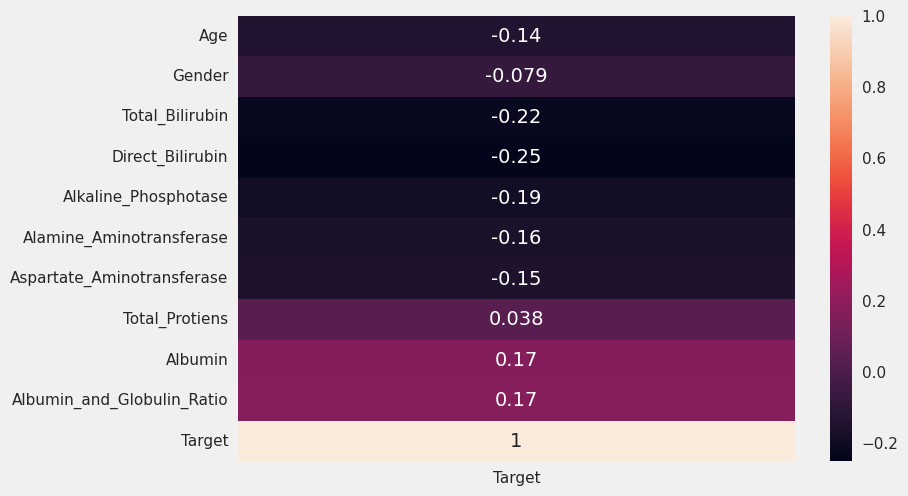

In [22]:
sns.heatmap(df_scaled.corr()[['Target']], annot= True)

plt.show()

No Correlation above 90 with the target so we aint removing a feature

## Variance Threshhold method

In [23]:
from sklearn.model_selection import train_test_split

from sklearn.feature_selection import VarianceThreshold as vt

X_train_vt, X_test_vt, y_train_vt, y_test_vt = train_test_split(X_scaled, y, test_size= 0.2, shuffle= True, random_state= 0)

var_thr = vt(threshold= 0.1)

var_thr.fit(X_train_vt)

print(var_thr.get_support())

print(sum(var_thr.get_support()))



[ True  True  True  True  True  True  True  True  True  True]
10


## Information Gain

In [24]:
liver_data_dep_list = []

from sklearn.feature_selection import mutual_info_classif

for rand_stat in range(0, 101):

  liver_data_dep = mutual_info_classif(X_scaled, y, random_state= rand_stat)

  liver_data_dep_df = pd.DataFrame(liver_data_dep, columns= ['Dependence'], index= X_scaled.columns)

  liver_data_dep_df_col = liver_data_dep_df[liver_data_dep_df['Dependence'] == 0]

  liver_data_dep_list.append([rand_stat, liver_data_dep_df_col.index])

liver_data_dep_list

[[0, Index(['Total_Protiens'], dtype='object')],
 [1, Index(['Total_Protiens'], dtype='object')],
 [2, Index(['Gender'], dtype='object')],
 [3, Index([], dtype='object')],
 [4, Index(['Total_Protiens'], dtype='object')],
 [5, Index(['Gender', 'Total_Protiens'], dtype='object')],
 [6, Index(['Gender', 'Total_Protiens'], dtype='object')],
 [7, Index(['Total_Protiens', 'Albumin_and_Globulin_Ratio'], dtype='object')],
 [8, Index(['Gender', 'Total_Protiens'], dtype='object')],
 [9, Index(['Gender', 'Total_Protiens'], dtype='object')],
 [10, Index(['Total_Protiens'], dtype='object')],
 [11, Index(['Total_Protiens'], dtype='object')],
 [12, Index(['Total_Protiens', 'Albumin'], dtype='object')],
 [13, Index(['Gender', 'Total_Protiens'], dtype='object')],
 [14, Index(['Gender'], dtype='object')],
 [15, Index(['Total_Protiens', 'Albumin'], dtype='object')],
 [16, Index(['Gender', 'Total_Protiens', 'Albumin'], dtype='object')],
 [17, Index([], dtype='object')],
 [18, Index(['Total_Protiens'], dty

Gender, Albumin and Total Proteins have mutual dependencies, theyre grouped together

we can't drop albumin and Total Proteins, theyre key features but Gender can be eliminated

## Chi Square Test

In [25]:
from sklearn.feature_selection import SelectKBest,f_classif, chi2

chi2_feat = SelectKBest(chi2, k= 8)

best_feat = chi2_feat.fit_transform(X, y)

best_feat_ind = chi2_feat.get_support(indices= True)

print(X.columns[[best_feat_ind]])

Index(['Age', 'Total_Bilirubin', 'Direct_Bilirubin', 'Alkaline_Phosphotase',
       'Alamine_Aminotransferase', 'Aspartate_Aminotransferase', 'Albumin',
       'Albumin_and_Globulin_Ratio'],
      dtype='object')


Those are the top 8 features and age is not one of them

## P-Value

In [26]:
k_best = SelectKBest(f_classif, k= 8)

k_best.fit_transform(X, y)

p_values = pd.DataFrame({'Column': X.columns, 'P-Value':k_best.pvalues_}).sort_values('P-Value')

p_values

,Column,P-Value
3,Direct_Bilirubin,1.290382e-09
2,Total_Bilirubin,6.106350e-08
4,Alkaline_Phosphotase,6.538991e-06
9,Albumin_and_Globulin_Ratio,4.258422e-05
8,Albumin,6.268356e-05
5,Alamine_Aminotransferase,1.032235e-04
6,Aspartate_Aminotransferase,2.941855e-04
0,Age,9.479293e-04
1,Gender,6.107474e-02
7,Total_Protiens,3.677655e-01


In [27]:
#Filtering out the columns whose p-values are less than 0.05, again Gender is not one of them

p_values[p_values['P-Value'] < 0.05]

,Column,P-Value
3,Direct_Bilirubin,1.290382e-09
2,Total_Bilirubin,6.106350e-08
4,Alkaline_Phosphotase,6.538991e-06
9,Albumin_and_Globulin_Ratio,4.258422e-05
8,Albumin,6.268356e-05
5,Alamine_Aminotransferase,1.032235e-04
6,Aspartate_Aminotransferase,2.941855e-04
0,Age,9.479293e-04


## Model Based Feature Selection

In [28]:
from sklearn.feature_selection import SelectFromModel

from sklearn.ensemble import RandomForestClassifier as rf

X_train_tb, X_test_tb, y_train_tb, y_test_tb = train_test_split(X_scaled, y, test_size= 0.2, shuffle= True, random_state= 0)

tb_model = SelectFromModel(rf(n_estimators= 50, random_state= 0))

tb_model.fit(X_train_tb, y_train_tb)



SelectFromModel(estimator=RandomForestClassifier(n_estimators=50,
                                                 random_state=0))

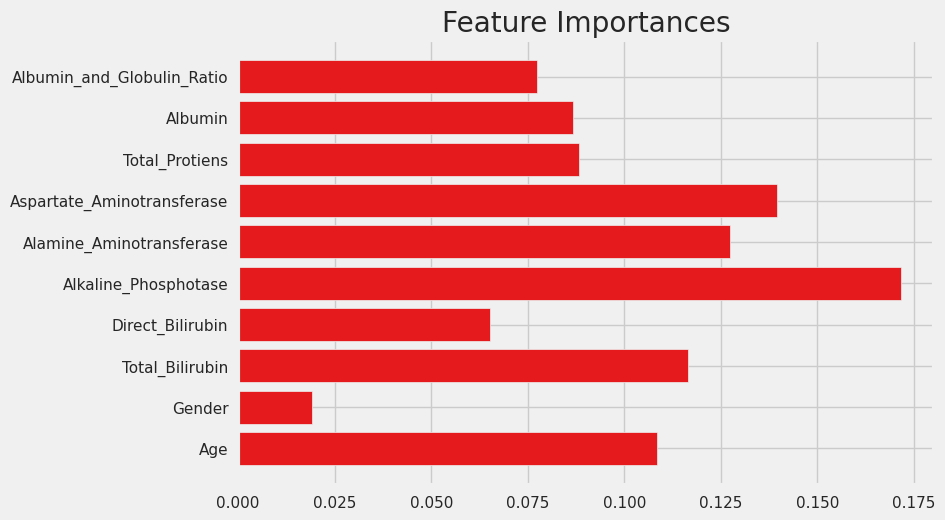

In [29]:
plt.barh(X_scaled.columns, tb_model.estimator_.feature_importances_)

plt.title("Feature Importances")

plt.show()

Gender is the least important

#Splitting the data

In [30]:
#Dropping the Gender Feature

X_scaled.drop(columns= 'Gender', inplace= True)

In [31]:
#Train Test Split

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size= 0.2,
                                                    shuffle= True, random_state= 0)

print("X train shape: ", X_train.shape)

print("y train shape: ", y_train.shape)

print("X test shape: ", X_test.shape)

print("y test shape: ", y_test.shape)


X train shape:  (456, 9)
y train shape:  (456,)
X test shape:  (114, 9)
y test shape:  (114,)


In [32]:
df['Target'].value_counts()

#The data is greatly imbalanced so we will have to apply smote analysis

1    406
2    164
Name: Target, dtype: int64

## Treating the imbalance in the data

In [33]:
from imblearn.over_sampling import SMOTE

smote = SMOTE()

X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

In [34]:
print("X train smote shape: ", X_train_smote.shape)

print("y train smote shape: ", y_train_smote.shape)

X train smote shape:  (660, 9)
y train smote shape:  (660,)


# Model Creation

## Logistic Regression

Logistic Regression Training Set score: 
 0.746969696969697
Logistic Regression Testing Set score: 
 0.6140350877192983
Logistic Regression Accuracy score:
  0.6140350877192983
Logistic Regression Classification Report:
                precision    recall  f1-score   support

           1       0.82      0.54      0.65        76
           2       0.45      0.76      0.57        38

    accuracy                           0.61       114
   macro avg       0.64      0.65      0.61       114
weighted avg       0.70      0.61      0.62       114



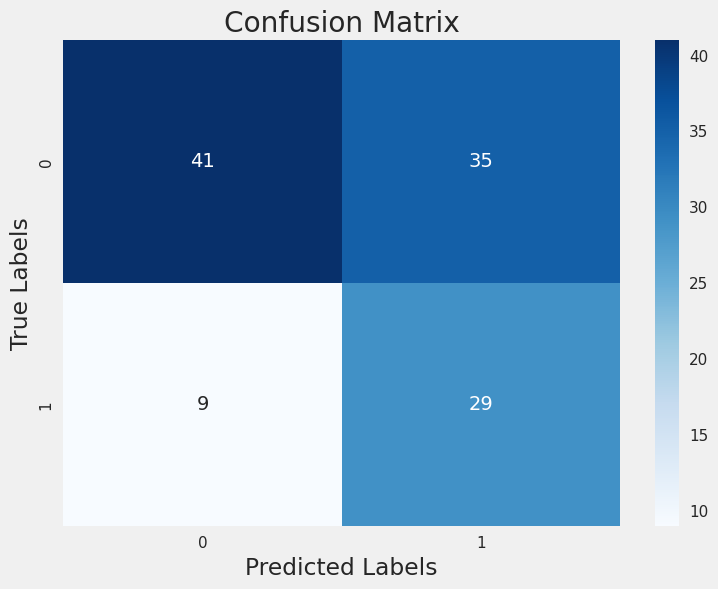

In [35]:
from sklearn.linear_model import LogisticRegression

from sklearn.metrics import *

model = LogisticRegression(solver= 'liblinear')

model.fit(X_train_smote, y_train_smote)

log_ypred = model.predict(X_test)

print("Logistic Regression Training Set score: \n", model.score(X_train_smote, y_train_smote))

print("Logistic Regression Testing Set score: \n", model.score(X_test, y_test))

print("Logistic Regression Accuracy score:\n ", accuracy_score(y_test, log_ypred))

print("Logistic Regression Classification Report:\n ", classification_report(y_test, log_ypred))

conf_mat = confusion_matrix(y_test, log_ypred)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Blues")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()

# Artificial Neural Network

Artificial Neural Network Training Set score: 
 0.8181818181818182
Artificial Neural Network Testing Set score: 
 0.6842105263157895
Artificial Neural Network Accuracy score:
  0.6842105263157895
Artificial Neural Network Classification Report:
                precision    recall  f1-score   support

           1       0.82      0.67      0.74        76
           2       0.52      0.71      0.60        38

    accuracy                           0.68       114
   macro avg       0.67      0.69      0.67       114
weighted avg       0.72      0.68      0.69       114



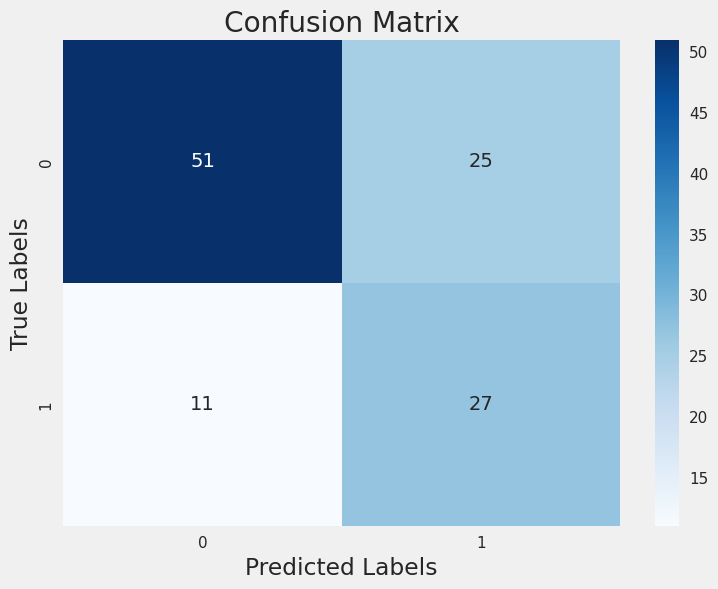

In [36]:
from sklearn.neural_network import MLPClassifier

ann = MLPClassifier(solver= 'sgd', hidden_layer_sizes= 100, max_iter= 1000, random_state= 1, learning_rate_init= .01)

ann.fit(X_train_smote, y_train_smote)

ann_ypred = ann.predict(X_test)

print("Artificial Neural Network Training Set score: \n", ann.score(X_train_smote, y_train_smote))

print("Artificial Neural Network Testing Set score: \n", ann.score(X_test, y_test))

print("Artificial Neural Network Accuracy score:\n ", accuracy_score(y_test, ann_ypred))

print("Artificial Neural Network Classification Report:\n ", classification_report(y_test, ann_ypred))

conf_mat = confusion_matrix(y_test, ann_ypred)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Blues")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()

## KNN Classifier

KNN Classifier Training Set score: 
 0.8803030303030303
KNN Classifier Testing Set score: 
 0.631578947368421
KNN Classifier Accuracy score:
  0.631578947368421
KNN Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.77      0.64      0.70        76
           2       0.46      0.61      0.52        38

    accuracy                           0.63       114
   macro avg       0.61      0.62      0.61       114
weighted avg       0.66      0.63      0.64       114



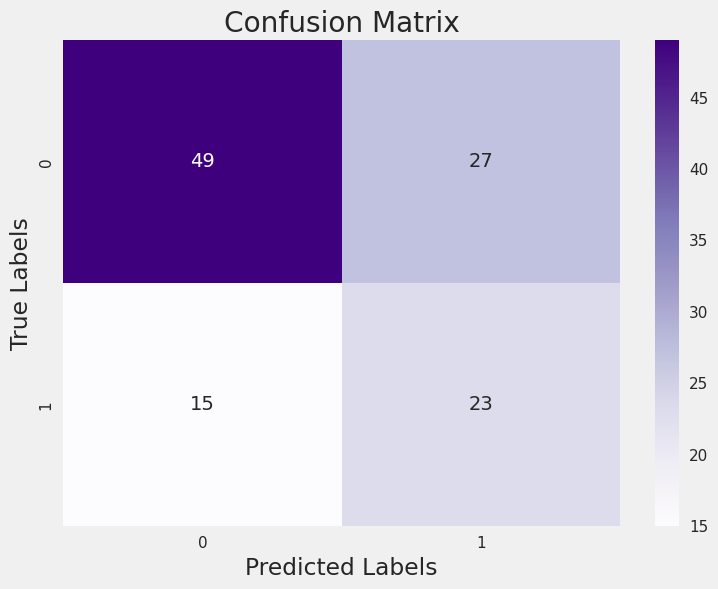

In [37]:
from sklearn.neighbors import KNeighborsClassifier as knn

model = knn(n_neighbors= 3)

model.fit(X_train_smote, y_train_smote)

knn_ypred = model.predict(X_test)

print("KNN Classifier Training Set score: \n", model.score(X_train_smote, y_train_smote))

print("KNN Classifier Testing Set score: \n", model.score(X_test, y_test))

print("KNN Classifier Accuracy score:\n ", accuracy_score(y_test, knn_ypred))

print("KNN Classifier Classification Report:\n ", classification_report(y_test, knn_ypred))

conf_mat = confusion_matrix(y_test, knn_ypred)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Purples")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()

## Decision Tree Classifier

Decision Tree Classifier Training Set score: 
 1.0
Decision Tree Classifier Testing Set score: 
 0.6491228070175439
Decision Tree Classifier Accuracy score:
  0.6491228070175439
Decision Tree Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.74      0.72      0.73        76
           2       0.47      0.50      0.49        38

    accuracy                           0.65       114
   macro avg       0.61      0.61      0.61       114
weighted avg       0.65      0.65      0.65       114



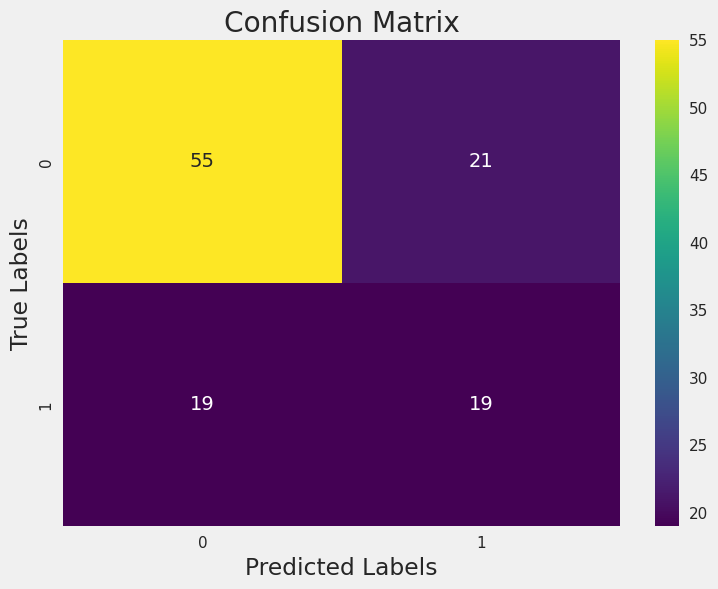

In [38]:
from sklearn.tree import DecisionTreeClassifier

dt = DecisionTreeClassifier()

dt.fit(X_train_smote, y_train_smote)

dt_ypred = dt.predict(X_test)

print("Decision Tree Classifier Training Set score: \n", dt.score(X_train_smote, y_train_smote))

print("Decision Tree Classifier Testing Set score: \n", dt.score(X_test, y_test))

print("Decision Tree Classifier Accuracy score:\n ", accuracy_score(y_test, dt_ypred))

print("Decision Tree Classifier Classification Report:\n ", classification_report(y_test, dt_ypred))

conf_mat = confusion_matrix(y_test, dt_ypred)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="viridis")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()

### Hyperparameter Tuning for Decision Tree Classifier using GridSearch CV

In [39]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
param_grid = {

              'criterion' : ['gini', 'entropy', 'log_loss'],

              'splitter' : ['random', 'best'],

              'max_depth' : (list(range(1,21))),

              'min_samples_leaf' : (list(range(1,21))),

              'max_features' : ['auto', 'sqrt', 'log2'],

              'min_samples_split' : [2,3,4,5]
}

dt_grid = GridSearchCV(estimator= dt, param_grid= param_grid, scoring= 'recall', cv= 5, n_jobs= -1)

dt_grid.fit(X_train_smote, y_train_smote)

print(dt_grid.best_params_)

{'criterion': 'gini', 'max_depth': 12, 'max_features': 'sqrt', 'min_samples_leaf': 15, 'min_samples_split': 3, 'splitter': 'random'}


### Implementation of the HyperParameters from GridSearchCV

In [40]:
dtg = DecisionTreeClassifier(criterion= 'gini', max_depth= 2,
                             max_features= 'sqrt', min_samples_leaf= 17,
                             min_samples_split= 2, splitter = 'random')

dtg.fit(X_train_smote, y_train_smote)

dtg_ypred = dtg.predict(X_test)

print("Grid Decision Tree Classifier Training Set score: \n", dtg.score(X_train_smote, y_train_smote))

print("Grid Decision Tree Classifier Testing Set score: \n", dtg.score(X_test, y_test))

print("Grid Decision Tree Classifier Accuracy score:\n ", accuracy_score(y_test, dtg_ypred))

print("Grid Decision Tree Classifier Classification Report:\n ", classification_report(y_test, dtg_ypred))

Grid Decision Tree Classifier Training Set score: 
 0.546969696969697
Grid Decision Tree Classifier Testing Set score: 
 0.40350877192982454
Grid Decision Tree Classifier Accuracy score:
  0.40350877192982454
Grid Decision Tree Classifier Classification Report:
                precision    recall  f1-score   support

           1       1.00      0.11      0.19        76
           2       0.36      1.00      0.53        38

    accuracy                           0.40       114
   macro avg       0.68      0.55      0.36       114
weighted avg       0.79      0.40      0.30       114



### Hyperparameter Tuning for Decision Tree Classifier using Randomized Search CV

In [41]:
dt_rand = RandomizedSearchCV(estimator= dt, param_distributions= param_grid,
                             n_jobs= -1, refit= True, cv= 5, scoring= 'recall')

dt_rand.fit(X_train_smote, y_train_smote)

print(dt_rand.best_params_)

{'splitter': 'random', 'min_samples_split': 2, 'min_samples_leaf': 20, 'max_features': 'sqrt', 'max_depth': 1, 'criterion': 'gini'}


### Implementation of the HyperParameters from RandomizedSearchCV

In [42]:
dtr = DecisionTreeClassifier(criterion= 'gini', max_depth= 1,
                             max_features= 'sqrt', min_samples_leaf= 20,
                             min_samples_split= 2, splitter = 'random')

dtr.fit(X_train_smote, y_train_smote)

dtr_ypred = dtr.predict(X_test)

print("Randomized Decision Tree Classifier Training Set score: \n", dtr.score(X_train_smote, y_train_smote))

print("Randomized Decision Tree Classifier Testing Set score: \n", dtr.score(X_test, y_test))

print("Randomized Decision Tree Classifier Accuracy score:\n ", accuracy_score(y_test, dtr_ypred))

print("Randomized Decision Tree Classifier Classification Report:\n ", classification_report(y_test, dtr_ypred))

Randomized Decision Tree Classifier Training Set score: 
 0.5318181818181819
Randomized Decision Tree Classifier Testing Set score: 
 0.37719298245614036
Randomized Decision Tree Classifier Accuracy score:
  0.37719298245614036
Randomized Decision Tree Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.86      0.08      0.14        76
           2       0.35      0.97      0.51        38

    accuracy                           0.38       114
   macro avg       0.60      0.53      0.33       114
weighted avg       0.69      0.38      0.27       114



The Untuned Decision Tree Classifier has a higher accuracy

### Visualizing the Decision Tree Classifier with the best accuracy

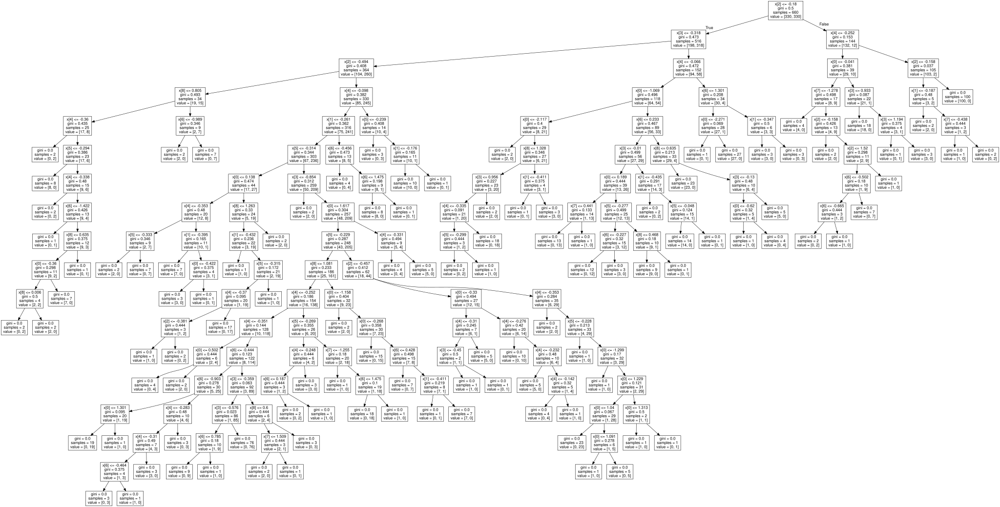

In [43]:
#Visualizing the decision Tree

import graphviz

from sklearn.tree import export_graphviz

dot_data = export_graphviz(dt, out_file= None)

graph = graphviz.Source(dot_data)

graph

## Random Forest

Random Forest Classifier Training Set score: 
 1.0
Random Forest Classifier Testing Set score: 
 0.6754385964912281
Random Forest Classifier Accuracy score:
  0.6754385964912281
Random Forest Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.77      0.74      0.75        76
           2       0.51      0.55      0.53        38

    accuracy                           0.68       114
   macro avg       0.64      0.64      0.64       114
weighted avg       0.68      0.68      0.68       114



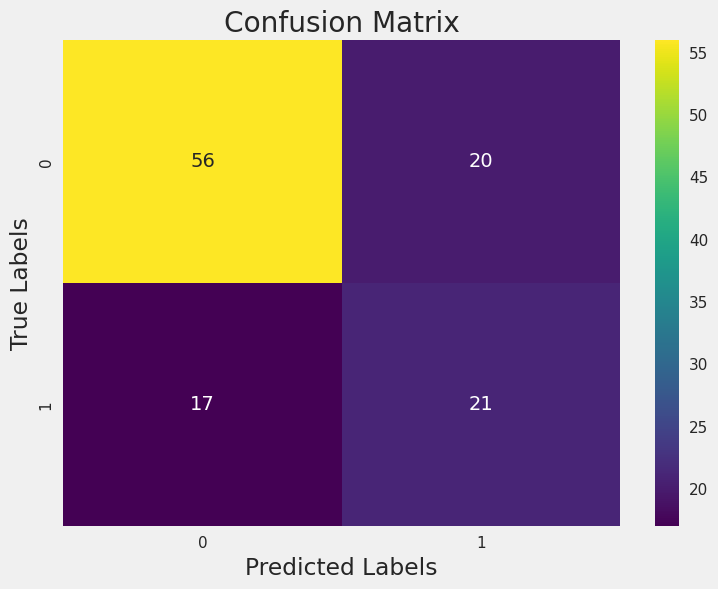

In [44]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()

rf.fit(X_train_smote, y_train_smote)

rf_ypred = rf.predict(X_test)

print("Random Forest Classifier Training Set score: \n", rf.score(X_train_smote, y_train_smote))

print("Random Forest Classifier Testing Set score: \n", rf.score(X_test, y_test))

print("Random Forest Classifier Accuracy score:\n ", accuracy_score(y_test, rf_ypred))

print("Random Forest Classifier Classification Report:\n ", classification_report(y_test, rf_ypred))

conf_mat = confusion_matrix(y_test, rf_ypred)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="viridis")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()

### Tuning the Random Forest Classifier using Randomized Search CV

In [45]:
param_grid = {

              'max_depth' : [int(y) for y in np.linspace(10, 110, 10)],

              'bootstrap' : [True, False],

              'min_samples_split' : [2,4,5],

              'min_samples_leaf' : [1,3,4],

              'max_features' : ['sqrt', 'log2', None],

              'n_estimators' : [int(x) for x in np.linspace(200, 2000, 10)]
}


rf_rand = RandomizedSearchCV(estimator= rf, param_distributions= param_grid,
                           n_jobs= -1, cv= 5, scoring= 'recall',
                           refit= True)

rf_rand.fit(X_train_smote, y_train_smote)

print(rf_rand.best_params_)

print(rf_rand.best_score_)

{'n_estimators': 1600, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 76, 'bootstrap': False}
0.7666666666666665


### Implementing the Randomized Search CV Hyperparameters

In [46]:
rf_rand = RandomForestClassifier(n_estimators= 1600, min_samples_split= 5, min_samples_leaf= 1,
                                 max_features= 'sqrt', max_depth= 76, bootstrap= False)

rf_rand.fit(X_train_smote, y_train_smote)

rf_rand_ypred = rf_rand.predict(X_test)

print("Rand Random Forest Classifier Training Set score: \n", rf_rand.score(X_train_smote, y_train_smote))

print("Rand Random Forest Classifier Testing Set score: \n", rf_rand.score(X_test, y_test))

print("Rand Random Forest Classifier Accuracy score:\n ", accuracy_score(y_test, rf_rand_ypred))

print("Rand Random Forest Classifier Classification Report:\n ", classification_report(y_test, rf_rand_ypred))


Rand Random Forest Classifier Training Set score: 
 1.0
Rand Random Forest Classifier Testing Set score: 
 0.6842105263157895
Rand Random Forest Classifier Accuracy score:
  0.6842105263157895
Rand Random Forest Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.75      0.79      0.77        76
           2       0.53      0.47      0.50        38

    accuracy                           0.68       114
   macro avg       0.64      0.63      0.63       114
weighted avg       0.68      0.68      0.68       114



The tuned Random Forest Model has a higher accuracy

## Bagging Classifier

Bagging Classifier:
> Accuracy on training data = 0.9318
> Accuracy on Testing data = 0.6667
Bagging Classifier Accuracy score:
  0.6666666666666666
Bagging Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.81      0.66      0.72        76
           2       0.50      0.68      0.58        38

    accuracy                           0.67       114
   macro avg       0.65      0.67      0.65       114
weighted avg       0.70      0.67      0.68       114



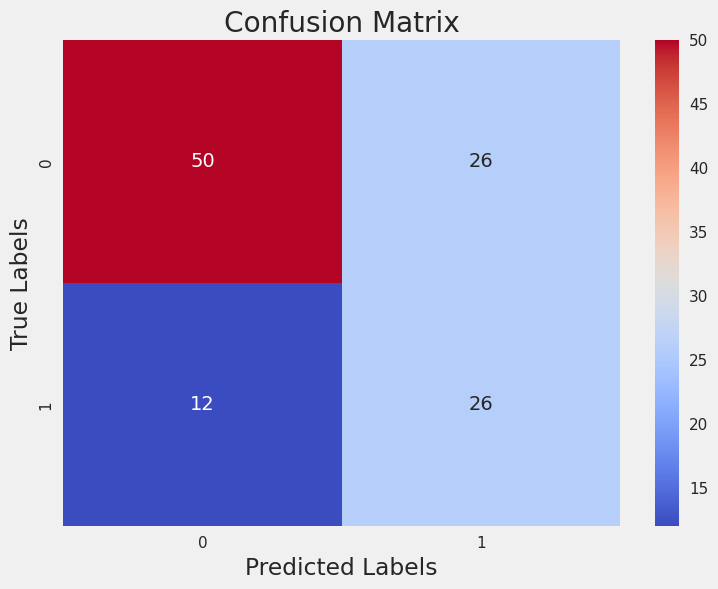

In [47]:
from sklearn.ensemble import BaggingClassifier

#Using the Random Forest Model as the base model

rf = RandomForestClassifier()

bc_params = {'base_estimator': rf, 'n_estimators': 50, 'max_samples': 0.5, 'random_state': 11, 'n_jobs': -1}

bc = BaggingClassifier(**bc_params)

bc.fit(X_train_smote, y_train_smote)

bc_ypreds_train = bc.predict(X_train_smote)

bc_ypreds_test = bc.predict(X_test)

print('Bagging Classifier:\n> Accuracy on training data = {:.4f}'

      '\n> Accuracy on Testing data = {:.4f}'.format(accuracy_score(y_true=y_train_smote,y_pred=bc_ypreds_train),accuracy_score(y_true=y_test, y_pred=bc_ypreds_test)))

print("Bagging Classifier Accuracy score:\n ", accuracy_score(y_test, bc_ypreds_test))

print("Bagging Classifier Classification Report:\n ", classification_report(y_test, bc_ypreds_test))

conf_mat = confusion_matrix(y_test, bc_ypreds_test)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="coolwarm")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()


## Gradient Boosting Classifiers

Gradient Boosting Classifier:
> Accuracy on training data = 0.9364
> Accuracy on testing data = 0.6579
Gradient Boosting Classifier Accuracy score:
  0.6578947368421053
Gradient Boosting  Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.77      0.70      0.73        76
           2       0.49      0.58      0.53        38

    accuracy                           0.66       114
   macro avg       0.63      0.64      0.63       114
weighted avg       0.68      0.66      0.66       114



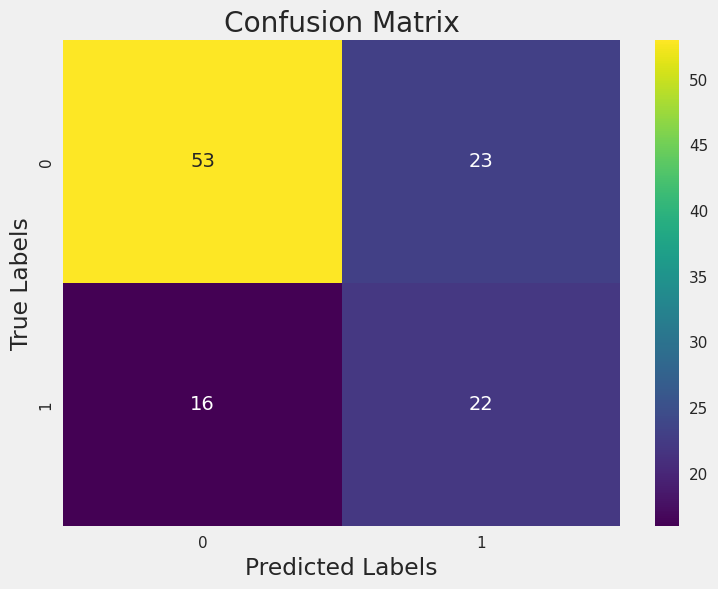

In [48]:
from sklearn.ensemble import GradientBoostingClassifier

gb = GradientBoostingClassifier()

gb.fit(X_train_smote, y_train_smote)

gb_ypred_train = gb.predict(X_train_smote)

gb_ypred_test = gb.predict(X_test)

print('Gradient Boosting Classifier:'\

      '\n> Accuracy on training data = {:.4f}'\

      '\n> Accuracy on testing data = {:.4f}'\

      .format(accuracy_score(y_true=y_train_smote, \

                             y_pred=gb_ypred_train), \

      accuracy_score(y_true=y_test, y_pred=gb_ypred_test)))

print("Gradient Boosting Classifier Accuracy score:\n ", accuracy_score(y_test, gb_ypred_test))

print("Gradient Boosting  Classifier Classification Report:\n ", classification_report(y_test, gb_ypred_test))

conf_mat = confusion_matrix(y_test, gb_ypred_test)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="viridis")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()

## AdaBoost Classifier

AdaBoost Classifier Accuracy score on Training Set: 0.7960526315789473
AdaBoost Classifier Accuracy score on Testing Set: 0.6403508771929824
AdaBoost Classifier Accuracy score:
  0.6403508771929824
AdaBoost Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.78      0.64      0.71        76
           2       0.47      0.63      0.54        38

    accuracy                           0.64       114
   macro avg       0.62      0.64      0.62       114
weighted avg       0.68      0.64      0.65       114



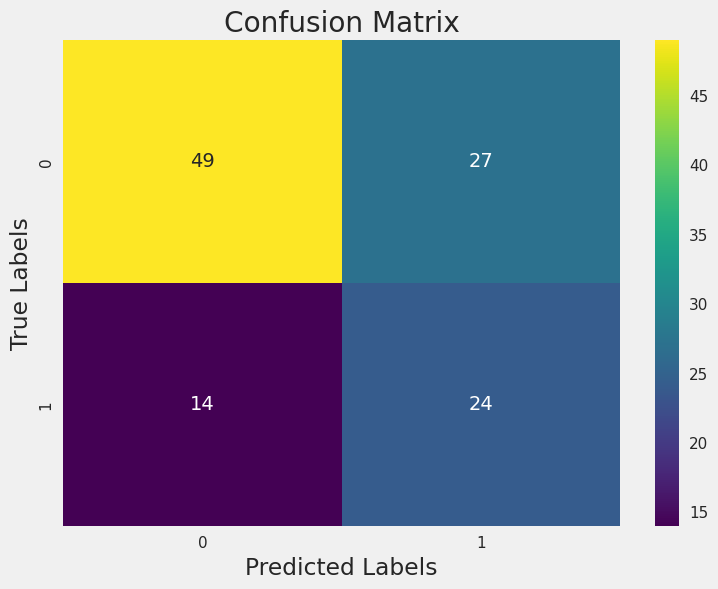

In [49]:
from sklearn.ensemble import AdaBoostClassifier

ad = AdaBoostClassifier()

ad.fit(X_train_smote, y_train_smote)

ad_ypred_test = ad.predict(X_test)

ad_ypred_train = ad.predict(X_train)

print("AdaBoost Classifier Accuracy score on Training Set:", accuracy_score(y_true= y_train, y_pred = ad_ypred_train))

print("AdaBoost Classifier Accuracy score on Testing Set:", accuracy_score(y_true= y_test, y_pred = ad_ypred_test))

print("AdaBoost Classifier Accuracy score:\n ", accuracy_score(y_test, ad_ypred_test))

print("AdaBoost Classifier Classification Report:\n ", classification_report(y_test, ad_ypred_test))

conf_mat = confusion_matrix(y_test, ad_ypred_test)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="viridis")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()

## Bagging AdaBoost with the Random Forest Classifier

Bagging AdaBoost Classifier:
> Accuracy on training data = 1.0000
> Accuracy on Testing data = 0.6404
Bagging AdaBoost Classifier Accuracy score:
  0.6403508771929824
Bagging AdaBoost Classifier Classification Report:
                precision    recall  f1-score   support

           1       0.73      0.74      0.73        76
           2       0.46      0.45      0.45        38

    accuracy                           0.64       114
   macro avg       0.59      0.59      0.59       114
weighted avg       0.64      0.64      0.64       114



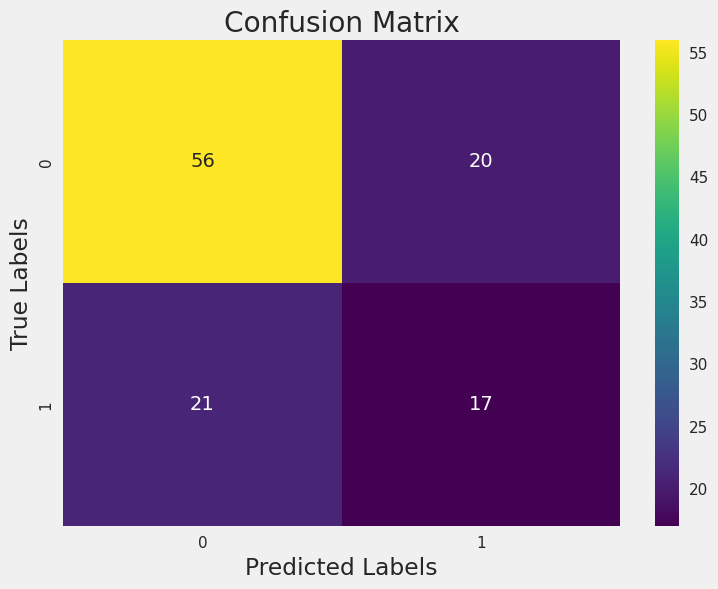

In [50]:
#Using the Random Forest Model as the base model

rf = RandomForestClassifier()

ad_params = {'n_estimators': 100, 'base_estimator': dt, \

             'random_state': 11}

ad = AdaBoostClassifier(**ad_params)

ad.fit(X_train_smote, y_train_smote)

ad_ypreds_train = ad.predict(X_train_smote)

ad_ypreds_test = ad.predict(X_test)

print('Bagging AdaBoost Classifier:\n> Accuracy on training data = {:.4f}'

      '\n> Accuracy on Testing data = {:.4f}'.format(accuracy_score(y_true=y_train_smote,y_pred=ad_ypreds_train),accuracy_score(y_true=y_test, y_pred=ad_ypreds_test)))

print("Bagging AdaBoost Classifier Accuracy score:\n ", accuracy_score(y_test, ad_ypreds_test))

print("Bagging AdaBoost Classifier Classification Report:\n ", classification_report(y_test, ad_ypreds_test))

conf_mat = confusion_matrix(y_test, ad_ypreds_test)

plt.figure(figsize=(8, 6))

sns.heatmap(conf_mat, annot=True, fmt="d", cmap="viridis")

plt.xlabel("Predicted Labels")

plt.ylabel("True Labels")

plt.title("Confusion Matrix")

plt.show()


#Stacking

In [51]:
# Base models

from sklearn.neighbors import KNeighborsClassifier

from sklearn.svm import LinearSVC

# Stacking model

from sklearn.linear_model import LogisticRegression

#Create a new training set with additional columns for predictions from base predictors.

x_train_with_metapreds = np.zeros((X_train_smote.shape[0], X_train_smote.shape[1]+2))

x_train_with_metapreds[:, :-2] = X_train_smote

x_train_with_metapreds[:, -2:] = -1

print(x_train_with_metapreds) #Observe two columns filled with -1

[[-0.4836799  -0.24299703 -0.24641707 ...  0.16334846 -1.
  -1.        ]
 [ 1.24174059 -0.22702881 -0.24641707 ... -1.15644974 -1.
  -1.        ]
 [-1.16152367 -0.41864741 -0.45837541 ...  0.47758612 -1.
  -1.        ]
 ...
 [ 0.45461693 -0.41420303 -0.45837541 ...  0.25080919 -1.
  -1.        ]
 [ 0.44078953 -0.43462006 -0.48192961 ... -1.68021704 -1.
  -1.        ]
 [ 0.09013136 -0.3577491  -0.37885656 ... -0.32772456 -1.
  -1.        ]]


In [52]:
from sklearn.model_selection import KFold
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsClassifier

kf = KFold(n_splits=5, random_state=11, shuffle=True)

# Convert X_train_smote to a pandas DataFrame (if it's not already)
X_train_smote = pd.DataFrame(X_train_smote)

for train_idx, test_idx in kf.split(X_train_smote):
    kfold_x_train, kfold_x_test = X_train_smote.iloc[train_idx], X_train_smote.iloc[test_idx]
    kfold_y_train, kfold_y_test = y_train_smote[train_idx], y_train_smote[test_idx]

    # Continue with your model training and prediction steps...
    # Create and train the SVM model
    svm = LinearSVC(random_state=11, max_iter=1000)
    svm.fit(kfold_x_train, kfold_y_train)

    # Predict with the SVM model
    svm_pred = svm.predict(kfold_x_test)

    # Create and train the k-NN model
    knn = KNeighborsClassifier(n_neighbors=4)
    knn.fit(kfold_x_train, kfold_y_train)

    # Predict with the k-NN model
    knn_pred = knn.predict(kfold_x_test)

    # Use SVM and k-NN predictions as meta-features (you need to define X_train_with_metapreds first)
    x_train_with_metapreds[test_idx, -2] = svm_pred
    x_train_with_metapreds[test_idx, -1] = knn_pred


In [53]:
x_test_with_metapreds = np.zeros((X_test.shape[0], X_test.shape[1]+2))

x_test_with_metapreds[:, :-2] = X_test

x_test_with_metapreds[:, -2:] = -1

print(x_test_with_metapreds)

[[ 0.00929738 -0.38671097 -0.42304902 ...  0.00622962 -1.
  -1.        ]
 [-0.73016855 -0.24299703 -0.24641707 ...  0.16334846 -1.
  -1.        ]
 [ 0.93362978 -0.43461562 -0.4937018  ...  0.47758612 -1.
  -1.        ]
 ...
 [ 0.31740818 -0.41864741 -0.4937018  ... -0.46512688 -1.
  -1.        ]
 [ 0.62551898  1.21011064  1.27261772 ... -1.40783988 -1.
  -1.        ]
 [-2.33234471 -0.45058384 -0.4937018  ...  0.47758612 -1.
  -1.        ]]


In [54]:
#Fitting the base models

svm = LinearSVC(random_state=11, max_iter=1000)

svm.fit(X_train_smote, y_train_smote)

knn = KNeighborsClassifier(n_neighbors=4)

knn.fit(X_train_smote, y_train_smote)

svm_pred = svm.predict(X_test)

knn_pred = knn.predict(X_test)

x_test_with_metapreds[:, -2] = svm_pred

x_test_with_metapreds[:, -1] = knn_pred

In [55]:
lr = LogisticRegression(random_state=11)

lr.fit(x_train_with_metapreds, y_train_smote)

lr_preds_train = lr.predict(x_train_with_metapreds)

lr_preds_val = lr.predict(x_test_with_metapreds)

print('Stacked Classifier:\n> Accuracy on training data = {:.4f}''\n> Accuracy on validation data = {:.4f}'.format(accuracy_score(y_true=y_train_smote, y_pred=lr_preds_train), accuracy_score(y_true=y_test, y_pred=lr_preds_val)))

Stacked Classifier:
> Accuracy on training data = 0.7364
> Accuracy on validation data = 0.6404


In [56]:
print('SVM:\n> Accuracy on training data = {:.4f}'
'\n> Accuracy on validation data = {:.4f}'
.format(accuracy_score(y_true=y_train_smote,
                       y_pred=svm.predict(X_train_smote)),
        accuracy_score(y_true=y_test, y_pred=svm_pred)))

print('kNN:\n> Accuracy on training data = {:.4f}'
'\n> Accuracy on validation data = {:.4f}'\
      .format(accuracy_score(y_true=y_train_smote,
                             y_pred=knn.predict(X_train_smote)), \
              accuracy_score(y_true=y_test, y_pred=knn_pred)))

SVM:
> Accuracy on training data = 0.7455
> Accuracy on validation data = 0.6140
kNN:
> Accuracy on training data = 0.8727
> Accuracy on validation data = 0.6404
